In [1]:
# Simulate neutrinos' system via exact application of Hamiltonian
# 2 flavor
# 3+1 dimensions

In [1]:
import numpy as np
from math import comb
from matplotlib import pyplot as plt

In [ ]:
# Set parameters in the Hamiltonianin unit of f=GF/sqrt(2)/V
angle = 26.56/180.*np.pi #Sin(2*angle)=0.8
wbar = 0.0   #dm**2/(4*T*f); term for vacuum oscillations
tbar = 10**1 #T/f

In [ ]:
# Set simulation set up
infile = 'fourmax_four'  # Input filename  
initj = int(4)         # Initial state
Ne = 1                 # Number of Electron Neutrinos
dt = 0.001              # Time step size
Nt = 10000              # Total time steps
pmax = 4

In [163]:
# Set up momentum modes
P = []
P_str = []
with open(infile+'_p.dat', 'r') as f:
    for lines in f.readlines():
        l = [x for x in lines.split(' ')]
        if l[0] == '#':
            pass
        else:
            lf = np.array([float(x) for x in lines.split(' ')])
            P.append(lf)
            P_str.append(str(lf))

In [164]:
# P = np.array(P)
K = len(P)
Nb = 2 * K

print(f'Number of momentum modes: {K}')

Number of momentum modes: 48


In [165]:
# List states

states = []

with open(infile+'_s.dat', 'r') as f:
    for lines in f.readlines():
        l = [int(x) for x in lines.split(' ')]
        nstate = int(2**len(l)/4**(len(l)-len(list(set(l))))) # all possible states (no flavor dependence)
        Nrp = len(l)-len(set(l))                              # number of repeats
        fc_nstate = comb(len(l)-2*Nrp, Ne-Nrp)
        print(f"nstate: {fc_nstate}, l={l}")
        
        rp = []                         #repeated momentum modes
        if nstate < 2**len(l):
            for i in range(len(l)-1):
                if l[i]==l[i+1]:
                    rp.append(l[i])

        nrp = [x for x in l if x not in rp] #nonrepeated momentum modes
        numnrp = len(nrp)                   #number of such modes

        #parity of integer in state represents flavor; 2^len(l) flavor combinations per l for nonrepeated
        for i in range(nstate):
            
            state = []
            evens = 0                   # number of even integers in state (number of electron neutrinos)

            for j in range(len(rp)):        # append duplicated modes twice
                state.append(2*rp[j])
                state.append(2*rp[j]+1)
                evens+=1
            
            for j in range(numnrp):
                value = (2*nrp[j]+(i//2**(numnrp-j-1))%2) # counts in binary
                state.append(value)
                
                if value % 2 == 0:
                       evens += 1

            if evens == Ne:
                states.append(sorted(state))

nstate: 5, l=[20, 21, 22, 23, 26]
nstate: 5, l=[1, 21, 22, 23, 45]
nstate: 5, l=[2, 21, 22, 23, 44]
nstate: 5, l=[3, 21, 22, 23, 43]
nstate: 5, l=[4, 21, 22, 23, 42]
nstate: 5, l=[6, 21, 22, 23, 40]
nstate: 5, l=[7, 21, 22, 23, 39]
nstate: 5, l=[8, 21, 22, 23, 38]
nstate: 5, l=[9, 21, 22, 23, 37]
nstate: 5, l=[10, 21, 22, 23, 36]
nstate: 5, l=[11, 21, 22, 23, 35]
nstate: 5, l=[13, 21, 22, 23, 33]
nstate: 5, l=[14, 21, 22, 23, 32]
nstate: 5, l=[15, 21, 22, 23, 31]
nstate: 5, l=[16, 21, 22, 23, 30]
nstate: 5, l=[17, 21, 22, 23, 29]
nstate: 5, l=[18, 21, 22, 23, 28]
nstate: 1, l=[21, 21, 22, 23, 25]
nstate: 1, l=[21, 22, 22, 23, 24]
nstate: 5, l=[0, 20, 22, 23, 47]
nstate: 5, l=[1, 20, 22, 23, 46]
nstate: 5, l=[2, 20, 22, 23, 45]
nstate: 5, l=[3, 20, 22, 23, 44]
nstate: 5, l=[4, 20, 22, 23, 43]
nstate: 5, l=[5, 20, 22, 23, 42]
nstate: 5, l=[6, 20, 22, 23, 41]
nstate: 5, l=[7, 20, 22, 23, 40]
nstate: 5, l=[8, 20, 22, 23, 39]
nstate: 5, l=[9, 20, 22, 23, 38]
nstate: 5, l=[10, 20, 22, 23, 37

In [166]:
print(f"{len(states)} basis states: \n{states}")

22832 basis states: 
[[40, 43, 45, 47, 53], [41, 42, 45, 47, 53], [41, 43, 44, 47, 53], [41, 43, 45, 46, 53], [41, 43, 45, 47, 52], [2, 43, 45, 47, 91], [3, 42, 45, 47, 91], [3, 43, 44, 47, 91], [3, 43, 45, 46, 91], [3, 43, 45, 47, 90], [4, 43, 45, 47, 89], [5, 42, 45, 47, 89], [5, 43, 44, 47, 89], [5, 43, 45, 46, 89], [5, 43, 45, 47, 88], [6, 43, 45, 47, 87], [7, 42, 45, 47, 87], [7, 43, 44, 47, 87], [7, 43, 45, 46, 87], [7, 43, 45, 47, 86], [8, 43, 45, 47, 85], [9, 42, 45, 47, 85], [9, 43, 44, 47, 85], [9, 43, 45, 46, 85], [9, 43, 45, 47, 84], [12, 43, 45, 47, 81], [13, 42, 45, 47, 81], [13, 43, 44, 47, 81], [13, 43, 45, 46, 81], [13, 43, 45, 47, 80], [14, 43, 45, 47, 79], [15, 42, 45, 47, 79], [15, 43, 44, 47, 79], [15, 43, 45, 46, 79], [15, 43, 45, 47, 78], [16, 43, 45, 47, 77], [17, 42, 45, 47, 77], [17, 43, 44, 47, 77], [17, 43, 45, 46, 77], [17, 43, 45, 47, 76], [18, 43, 45, 47, 75], [19, 42, 45, 47, 75], [19, 43, 44, 47, 75], [19, 43, 45, 46, 75], [19, 43, 45, 47, 74], [20, 43,

In [167]:
Nn = len(l)
bstr_to_j = {}
j_to_bstr = {}
Ns = len(states)
for i in range(Ns):
    b = ','.join(str(int(x)) for x in states[i])
    bstr_to_j[b] = i 
    j_to_bstr[i] = b


print(f'The number of basis states: {Ns}')
print(f'The number of neutrinos: {Nn}')
print(f'The number of electron neutrinos: {Ne}')

The number of basis states: 22832
The number of neutrinos: 5
The number of electron neutrinos: 1


In [168]:
# Input is a state's binary representation, return its basis index j
def b_to_j(b):
    oc = []
    for i in range(Nb):
        if b[i]==1:
            oc.append(i)
    bstr = ','.join(str(x) for x in oc)
    return bstr_to_j[bstr]

In [169]:
# Input is the basis index j, and returns its binary representation
def j_to_b(j):
    bstr = j_to_bstr[j]
    oc = [int(x) for x in bstr.split(',')]
    b = [0]*Nb
    for i in range(len(oc)):
        b[oc[i]] = 1
    return b

In [170]:
# Given neutrino's mode index and flavor, return its bin number k = K*p + flavor
def bin(p, flavor):
    return 2*p + flavor

In [171]:
# Applying a*(b1)a(b2) to a basis state, b = [b1,b2]
def quad(b, basis):
    basis_copy = basis.copy()
    l = 1
    f = 1.0

    #a(b2)
    if basis_copy[b[1]] == 0:
        l = 0
    else:
        basis_copy[b[1]] = 0
        f = f * (-1)**np.sum(basis_copy[:b[1]])
    
    #a*(b1)
    if basis_copy[b[0]] ==1:
        l = 0
    else:
        basis_copy[b[0]] = 1
        f = f * (-1)**np.sum(basis_copy[:b[0]])
    
    return l, f, basis_copy

In [172]:
# Applying a*(b1)a*(b2)a(b3)a(b4) to state, b = [b1,b2,b3,b4]
def quar(b, basis):
    basis_copy = basis.copy()
    l = 1
    f = 1.0
    if basis_copy[b[3]] == 0:
        l = 0
    else:
        basis_copy[b[3]] = 0
        f = f * (-1)**np.sum(basis_copy[:b[3]])
    if basis_copy[b[2]] == 0:
        l = 0
    else:
        basis_copy[b[2]] = 0
        f = f * (-1)**np.sum(basis_copy[:b[2]])
    if basis_copy[b[1]] ==1:
        l = 0
    else:
        basis_copy[b[1]] = 1
        f = f * (-1)**np.sum(basis_copy[:b[1]])
    if basis_copy[b[0]] ==1:
        l = 0
    else:
        basis_copy[b[0]] = 1
        f = f * (-1)**np.sum(basis_copy[:b[0]])

    return l, f, basis_copy

In [173]:
# mass term applied to basis state j; for vacuum oscillations: 0 for w-bar/T-bar = 0; turned off for flavor conservation
def mass(j):
    sin = j_to_b(j)
    state = np.zeros(Ns) * 1j
    for p in range(K):
        ke = bin(p, 0)
        km = bin(p, 1)
        absp = np.sqrt(np.sum(P[p]*P[p]))
        factor_ee = tbar*absp - np.cos(2*angle)*wbar/absp
        factor_mm = tbar*absp + np.cos(2*angle)*wbar/absp
        factor_em = np.sin(2*angle)*wbar/absp
        factor_me = factor_em
        t, fa, sout = quad([ke, ke], sin)
        # e -> e
        if t == 1:
            state[b_to_j(sout)] += fa * factor_ee 
        t, fa, sout = quad([km, km], sin) 
        # mu -> mu
        if t == 1:
            state[b_to_j(sout)] += fa * factor_mm 
        
        #TURNED OFF FOR wbar=0.0
        # # mu -> e 
        # t, fa, sout = quad([ke, km], sin) 
        # if t == 1:
        #     state[b_to_j(sout)] += fa * factor_em 
        # # e -> mu
        # t, fa, sout = quad([km, ke], sin) 
        # if t == 1:
        #     state[b_to_j(sout)] += fa * factor_me 

    return state

In [174]:
flavor_pair = np.array([[0,0],[0,1],[1,0],[1,1]]) # flavor (alpha, beta)

In [175]:
# Input is 3-dim momentum, returns |p|, theta and phi (0-2pi)
def p_spherical(p):
    absp = np.sqrt(np.sum(p*p))
    theta = np.arctan2(np.sqrt(p[0]**2+p[1]**2), p[2])
    phi = np.arctan2(p[1],p[0])
    return absp, theta, phi

In [176]:
# g factor for H_vv
def g_factor(p1, p2, q1, q2):
    absp1, tp1, pp1 = p_spherical(p1)
    absp2, tp2, pp2 = p_spherical(p2)
    absq1, tq1, pq1 = p_spherical(q1)
    absq2, tq2, pq2 = p_spherical(q2)
    fac1 = np.exp(-1j*pq1)*np.sin(tq1/2.)*np.cos(tq2/2.) - np.exp(-1j*pq2)*np.cos(tq1/2.)*np.sin(tq2/2.)
    fac2 = np.exp(1j*pp1)*np.sin(tp1/2.)*np.cos(tp2/2.) - np.exp(1j*pp2)*np.cos(tp1/2.)*np.sin(tp2/2.)
    return 2 * fac1 * fac2


In [ ]:
# # Create a list of conserving 4 momenta p1+p2 = p3+p4
# print(f'Creating the list of conserved 4 momenta')
# momenta4 = []
# gfactors = []
# for i1 in range(K):
#     p1 = P[i1]
#     for i2 in range(K):
#         p2 = P[i2]
#         for i3 in range(K):
#             p3 = P[i3]
#             for i4 in range(K):
#                 p4 = P[i4]
#                 pdiff = p1+p2-p3-p4
#                 if np.sum(np.abs(pdiff)) < 1e-7:
#                     # k1 = np.sqrt(np.sum(p1*p1))
#                     # k2 = np.sqrt(np.sum(p2*p2))
#                     # k3 = np.sqrt(np.sum(p3*p3))
#                     # k4 = np.sqrt(np.sum(p4*p4))
#                     gfactor = g_factor(p1,p2,p3,p4)
#                     if np.abs(gfactor) > 1e-7: #ensuring only appending terms where g>0
#                         momenta4.append([i1, i2, i3, i4])
#                         gfactors.append(gfactor)


Creating the list of conserved 4 momenta


In [177]:
# Create a list of conserving 4 momenta p1+p2 = p3+p4
print(f'Creating the list of conserved 4 momenta')
momenta4 = []
gfactors = []
for i1 in range(K):
    p1 = np.array(P[i1])
    for i2 in range(K):
        p2 = np.array(P[i2])
        for i3 in range(K):
            p3 = np.array(P[i3])
            p4 =  p1+p2-p3
            p4_mag = np.linalg.norm(p4)
            if p4_mag <= pmax and p4_mag != 0:
                i4 = P_str.index(str(p4))
                gfactor = g_factor(p1,p2,p3,p4)
                if np.abs(gfactor) > 1e-7: #ensuring only appending terms where g>0
                    momenta4.append([i1, i2, i3, i4])
                    gfactors.append(gfactor)


Creating the list of conserved 4 momenta


In [19]:
momenta4 = np.array(momenta4)
gfactors = np.array(gfactors)
print(f'Number of conserved P and conserved E pairs: {len(momenta4)}')

Number of conserved P and conserved E pairs: 46288


In [20]:
# full 4 fermi interaction term applied to basis state j.
# a*(p1,fp1)a*(p2,fp2)a(q1,fq1)a(q2,fq2) with p1+p2 = q1+q2
def vv_full(j):
    sin = j_to_b(j)
    state = np.zeros(Ns) * 1j
    for i in range(len(momenta4)):
        p1 = momenta4[i,0]
        p2 = momenta4[i,1]
        q1 = momenta4[i,2]
        q2 = momenta4[i,3] 
        factor = - gfactors[i]
        for f in range(4):
            i1 = bin(p1, flavor_pair[f,0])
            i2 = bin(p2, flavor_pair[f,1])
            i3 = bin(q1, flavor_pair[f,0])
            i4 = bin(q2, flavor_pair[f,1])
            t, fa, sout = quar([i1, i2, i3, i4], sin)
            if t == 1:
                state[b_to_j(sout)] += fa * factor
    return state

In [21]:
# Construct Hamiltonian
H = np.zeros((Ns, Ns))*1j

for i in range(Ns):
    column = np.zeros(Ns)*1j
    H[:,i] += mass(i)              #must turn off vacuum oscillations to maintain flavor conservation
    H[:,i] += vv_full(i)
    if i%100==0:
        print(f'constructing {i}th column of the Hamiltonian')

constructing 0th column of the Hamiltonian


In [22]:
# Diaginalize H and construct time evolution operator U
# Full Hamiltonian
hvals, hvecs = np.linalg.eigh(H) 
U = hvecs @ np.diag(np.exp(-dt*hvals*1j)) @ hvecs.conj().T

In [23]:
# norm and observables of interest
def norm(state):
    return np.sqrt(np.sum(state * state.conj()))

# input is the state vector, returns the # of neutrino in each bin (Nb)
def observable(state):
    obs = np.zeros(Nb)
    for i in range(Ns):
        binary = j_to_b(i)
        obs += np.abs(state[i])**2*np.array(binary)
    return obs

# returns string of time and wave function amplitude
def print_cstr(state,i):
    return str(i*dt) + ' ' + ' '.join([str(x) for x in state]) 

# returns string of time and occupation number per bin
def print_nstr(state,i):
    obs = observable(state)
    return str(i*dt) + ' ' + ' '.join([str(x) for x in obs])

In [24]:
# Time evolution from the initial state j    
state = np.zeros(Ns)*1j
state[initj] = 1.0

ts = []
tstates = []

# print initial state 
ts.append(0)
tstates.append(observable(state))
print(print_nstr(state, 0))


for i in range(1,Nt+1):
    state = U @ state
    n = norm(state)
    if abs(n-1.) > 1e-5:
        print('Norm off by > 1e-5 at time ', i*dt)
        break
    
    ts.append(i*dt)
    tstates.append(observable(state))
    print(print_nstr(state, i))


0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
0.001 1.5942293409319814e-05 1.594229340931912e-05 1.593944077581574e-05 1.5939440775816085e-05 1.593603824285417e-05 1.5936038242854217e-05 1.5934740553308604e-05 1.593474055330868e-05 1.5936038242852832e-05 1.593603824285383e-05 1.5939440775816153e-05 1.5939440775816377e-05 1.5939440775816153e-05 1.5939440775816065e-05 1.5933338196833634e-05 1.5933338196833634e-05 1.5928256964230385e-05 1.5928256964230744e-05 1.5926128495090388e-05 1.5926128495090436e-05 1.5928256964230392e-05 1.5928256964230524e-05 1.5933338196833868e-05 1.59333381968338e-05 1.5939440775816092e-05 1.593944077581616e-05 1.59360382428533

In [78]:
def Npm(i, tstates):
    Np = []
    Nm = []

    for state in tstates:
        Np.append((state[2*i] + state[2*i+1]))
        Nm.append((state[2*i] - state[2*i+1]))

    return Np, Nm

In [79]:
def Np_plots(state):
    Nps = []

    for i in range(K):
        Np = Npm(i, state)[0]
        Nps.append(Np)

    return Nps

In [25]:
file = open(infile+'_T1.dat', 'w')
file.write(f'# tbar: {tbar} \n')
file.write(f'# initj: {initj} \n')
file.write(f'# Ne: {Ne} \n')
file.write(f'# dt: {dt} \n')
file.write(f'# Nt: {Nt} \n')

for state in tstates:
    file.write(str(list(map(float, state))))
    file.write('\n')

file.close()

# $\bar{T}=1$

In [115]:
r = open(infile+'_T0.dat', 'r')
content = r.read().replace('[', '').replace(']','').split('\n')
r.close()

states_read = (list(eval(str(content))))[5:] #ignores first 5 lines of comments


T0 = []
for i in range(len(states_read)-1):
    T0.append(list(eval(states_read[i])))

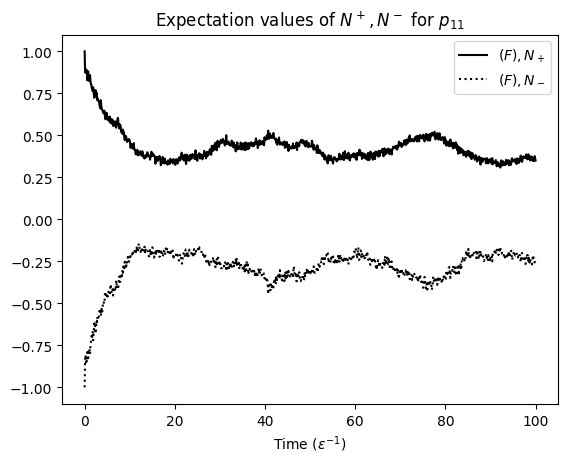

In [116]:

Np11T0, Nm11T0 = Npm(11, T0)


plt.plot(ts, Np11T0, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm11T0, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{11}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');


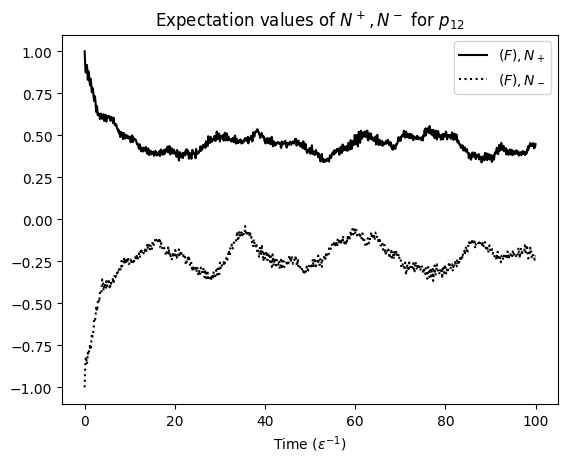

In [117]:
Np12T0, Nm12T0 = Npm(12, T0)


plt.plot(ts, Np12T0, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm12T0, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{12}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');


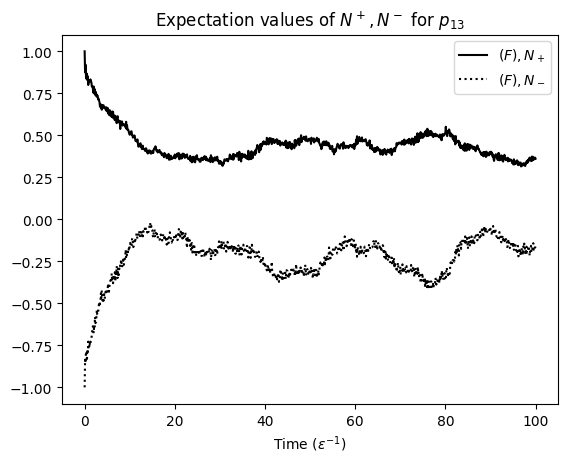

In [118]:
Np13T0, Nm13T0 = Npm(13, T0)


plt.plot(ts, Np13T0, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm13T0, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{13}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');


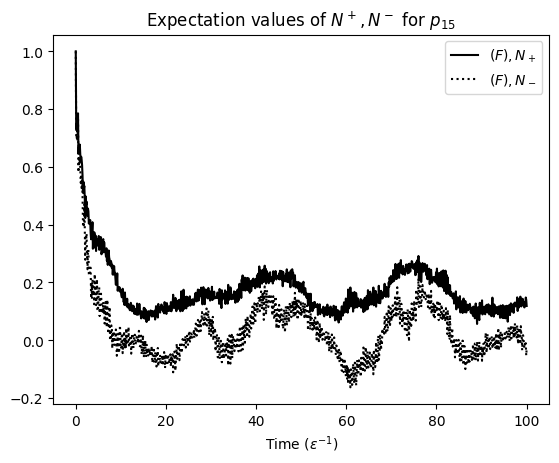

In [119]:
Np15T0, Nm15T0 = Npm(15, T0)


plt.plot(ts, Np15T0, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm15T0, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{15}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');


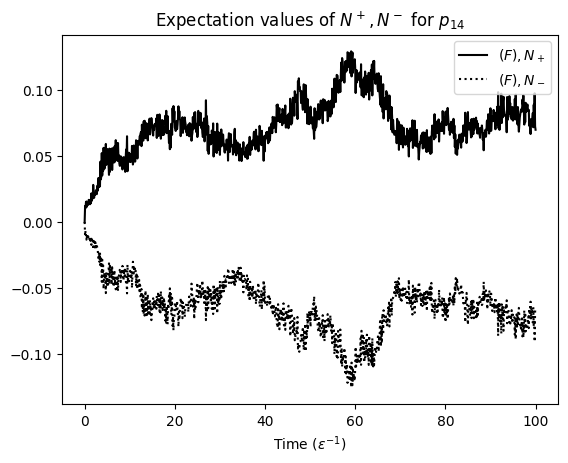

In [120]:
Np14T0, Nm14T0 = Npm(14, T0)


plt.plot(ts, Np14T0, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm14T0, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{14}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

# $\bar{T}=10$

In [ ]:
# file =  open(infile+'_T1.dat', 'w')
# file.write(f'# tbar: {tbar} \n')
# file.write(f'# initj: {initj} \n')
# file.write(f'# Ne: {Ne} \n')
# file.write(f'# dt: {dt} \n')
# file.write(f'# Nt: {Nt} \n')

# for state in tstates:
#     file.write(str(list(map(float, state))))
#     file.write('\n')

# file.close()

In [9]:
r = open(infile+'_T1.dat', 'r')
content = r.read().replace('[', '').replace(']','').split('\n')
r.close()

states_read = (list(eval(str(content))))[5:] #ignores first 5 lines of comments


T1 = []
ts = []
for i in range(len(states_read)-1):
    T1.append(list(eval(states_read[i])))
    ts.append(i*dt)


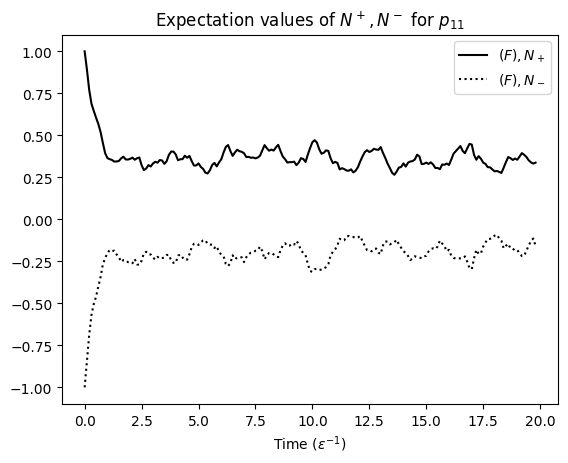

In [14]:
Np11T1, Nm11T1 = Npm(11, T1)


plt.plot(ts[0:199], Np11T1[0:199], label=r'$(F), N_+$', color='black')
plt.plot(ts[0:199], Nm11T1[0:199], label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{11}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

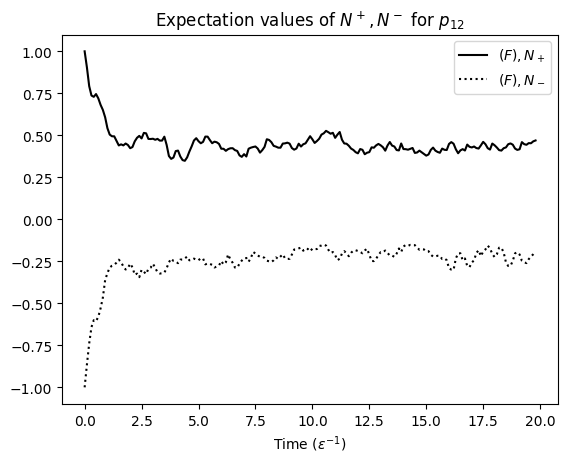

In [16]:
Np12T1, Nm12T1 = Npm(12, T1)


plt.plot(ts[0:199], Np12T1[0:199], label=r'$(F), N_+$', color='black')
plt.plot(ts[0:199], Nm12T1[0:199], label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{12}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

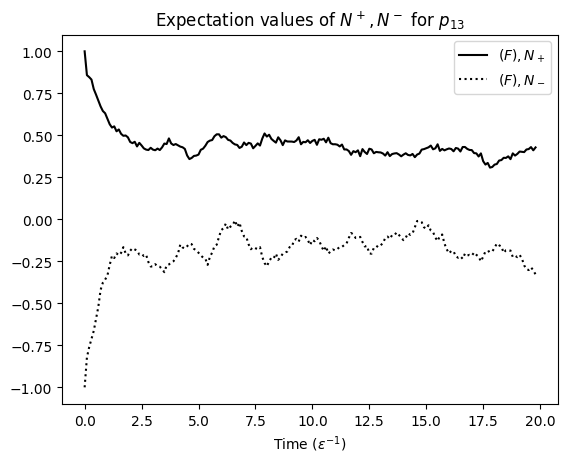

In [17]:
Np13T1, Nm13T1 = Npm(13, T1)


plt.plot(ts[0:199], Np13T1[0:199], label=r'$(F), N_+$', color='black')
plt.plot(ts[0:199], Nm13T1[0:199], label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{13}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

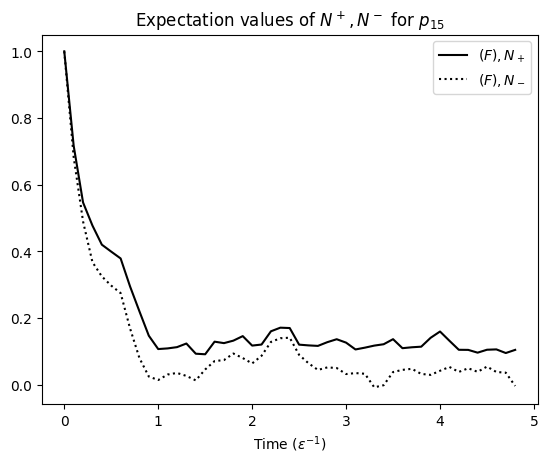

In [20]:
Np15T1, Nm15T1 = Npm(15, T1)


plt.plot(ts[0:49], Np15T1[0:49], label=r'$(F), N_+$', color='black')
plt.plot(ts[0:49], Nm15T1[0:49], label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{15}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

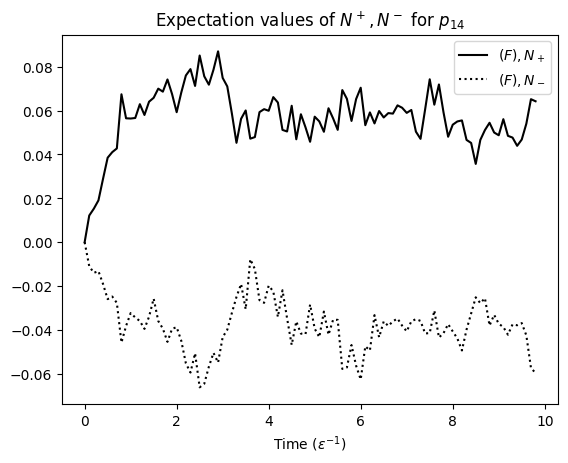

In [22]:
Np14T1, Nm14T1 = Npm(14, T1)


plt.plot(ts[0:99], Np14T1[0:99], label=r'$(F), N_+$', color='black')
plt.plot(ts[0:99], Nm14T1[0:99], label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{14}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

# $\bar{T}=10^2$

In [ ]:
# file =  open(infile+'_T2.dat', 'w')
# file.write(f'# tbar: {tbar} \n')
# file.write(f'# initj: {initj} \n')
# file.write(f'# Ne: {Ne} \n')
# file.write(f'# dt: {dt} \n')
# file.write(f'# Nt: {Nt} \n')

# for state in tstates:
#     file.write(str(list(map(float, state))))
#     file.write('\n')

# file.close()

In [127]:
r = open(infile+'_T2.dat', 'r')
content = r.read().replace('[', '').replace(']','').split('\n')
r.close()

states_read = (list(eval(str(content))))[5:] #ignores first 5 lines of comments

T2 = []
for i in range(len(states_read)-1):
    T2.append(list(eval(states_read[i])))

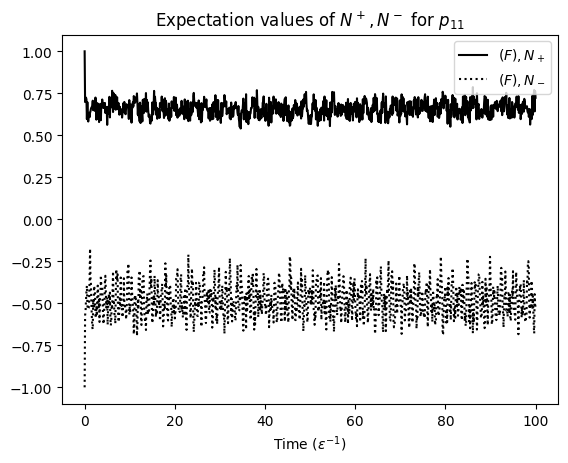

In [128]:
Np11T2, Nm11T2 = Npm(11, T2)


plt.plot(ts, Np11T2, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm11T2, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{11}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

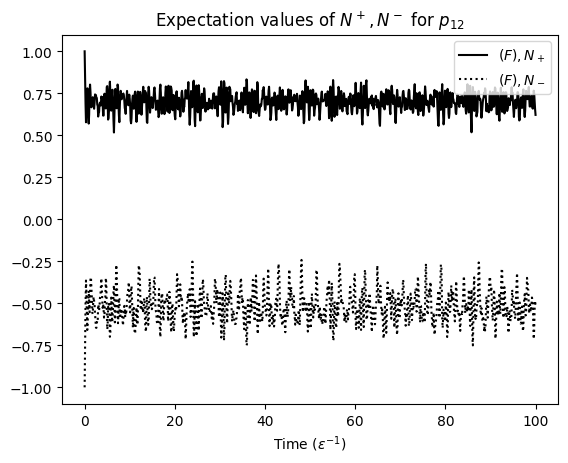

In [129]:
Np12T2, Nm12T2 = Npm(12, T2)


plt.plot(ts, Np12T2, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm12T2, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{12}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

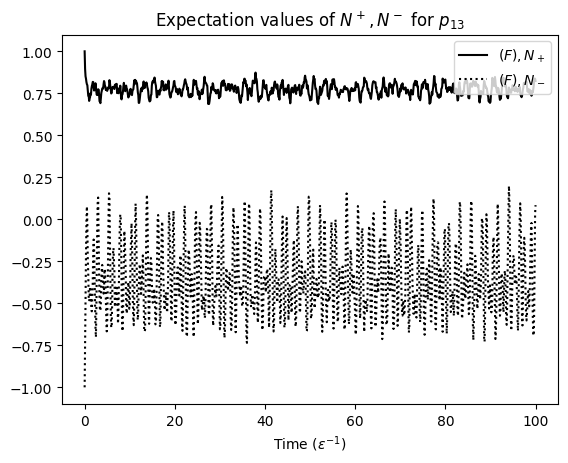

In [130]:
Np13T2, Nm13T2 = Npm(13, T2)


plt.plot(ts, Np13T2, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm13T2, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{13}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

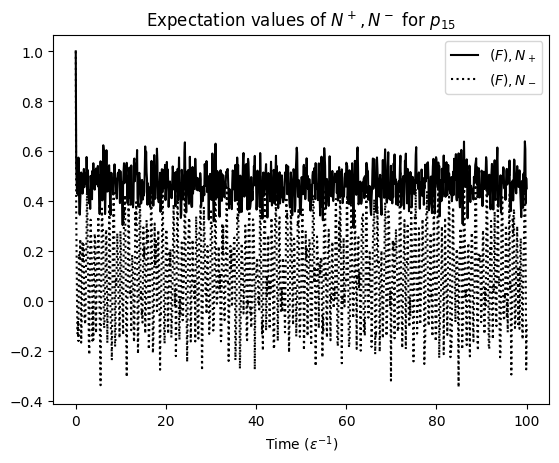

In [131]:
Np15T2, Nm15T2 = Npm(15, T2)


plt.plot(ts, Np15T2, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm15T2, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{15}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

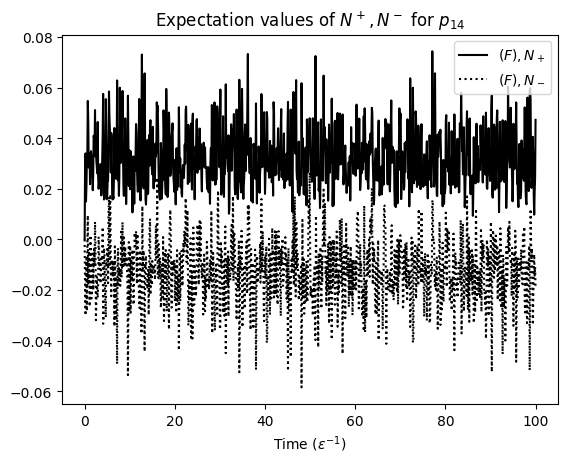

In [132]:
Np14T2, Nm14T2 = Npm(14, T2)


plt.plot(ts, Np14T2, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm14T2, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{14}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

# $\bar{T}=10^3$

In [133]:
r = open(infile+'_T3.dat', 'r')
content = r.read().replace('[', '').replace(']','').split('\n')
r.close()

states_read = (list(eval(str(content))))[5:] #ignores first 5 lines of comments

T3 = []
for i in range(len(states_read)-1):
    T3.append(list(eval(states_read[i])))

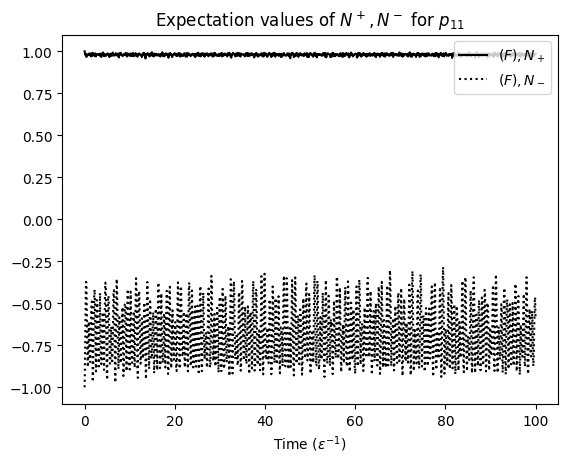

In [134]:
Np11T3, Nm11T3 = Npm(11, T3)


plt.plot(ts, Np11T3, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm11T3, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{11}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

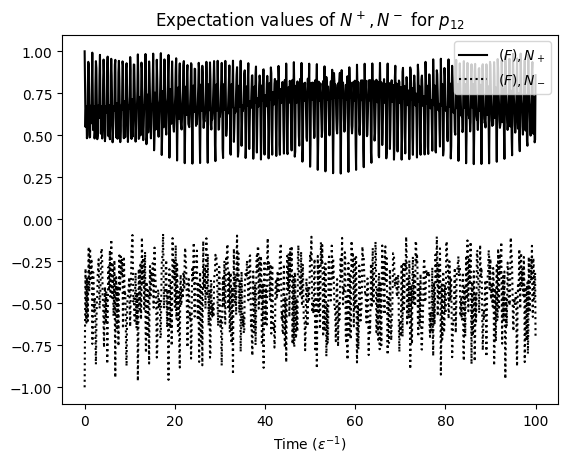

In [135]:
Np12T3, Nm12T3 = Npm(12, T3)


plt.plot(ts, Np12T3, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm12T3, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{12}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

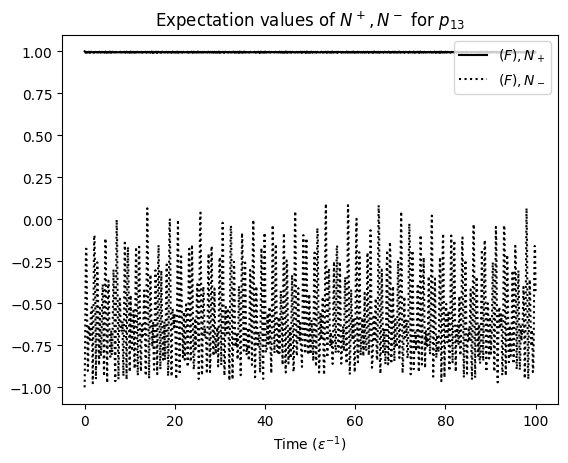

In [136]:
Np13T3, Nm13T3 = Npm(13, T3)


plt.plot(ts, Np13T3, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm13T3, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{13}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

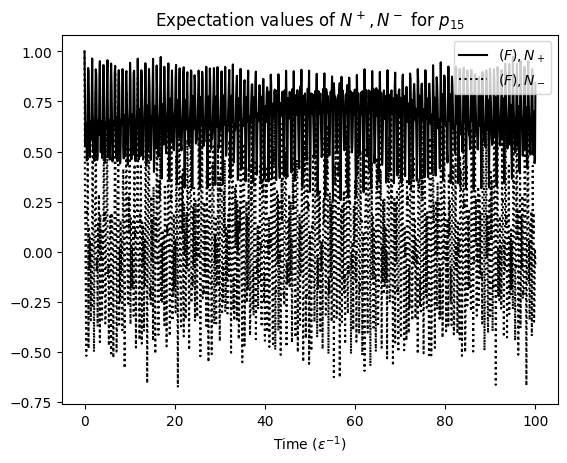

In [137]:
Np15T3, Nm15T3 = Npm(15, T3)


plt.plot(ts, Np15T3, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm15T3, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{15}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');

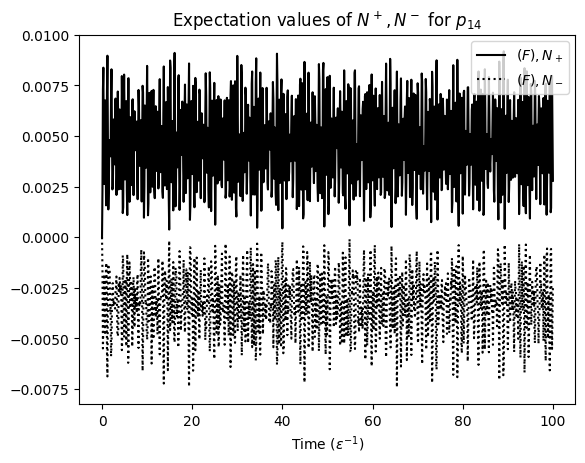

In [138]:
Np14T3, Nm14T3 = Npm(14, T3)


plt.plot(ts, Np14T3, label=r'$(F), N_+$', color='black')
plt.plot(ts, Nm14T3, label=r'$(F), N_-$', color='black', linestyle=':')


plt.title(r"Expectation values of $N^+, N^-$ for $p_{14}$");
plt.xlabel(r"Time ($\epsilon^{-1}$)");
plt.legend(loc='upper right');